<hr style="border:2px solid gray"> </hr>
<img src="https://mma.prnewswire.com/media/1095203/East_Tennessee_State_University_Logo.jpg?p=facebook" width=200 height=200 />

<div class="alert alert-block alert-info">
    <h1 style="text-align: center">CSCI 5270 - Machine Learning</h1>
</div>

# <center>Lab 2 - Binary and Multi-class Classification Using Logistic Regression</center>

**<center>Dr. Ahmad Al-Doulat </center>**
<center>Department of Computing </center>
<center>East Tennessee State University</center>

<hr style="border:2px solid lightblue"> </hr>

**In this assignment, you'll get to practice the concepts and skills covered in the course so far. The main objective of this assignment is to implement, test and evaluate two logistic regression models- Binary and Multi-class Classification Using Logistic Regression.**



**Guidelines**
* Download `weatherAUS.csv` and `penguins.csv` files from D2L. 
* Make sure to run all the code cells, otherwise you may get errors like `NameError` for undefined variables.
* Do not change variable names, delete cells or disturb other existing code. It may cause problems during evaluation.
* In some cases, you may need to add some code cells or new statements before or after the line of code containing the `???`.
* Use markdown cells to write your discussions and reflections. 

**Procedure**
* Save your work as `IPYNB` file and submit to D2L `Lab 2 - Binary and Multi-class Classification Using Logistic Regression (Dropbox)` by the due date.
* As you go through this notebook, you will find the symbol `???` in certain places. To complete this assignment, you must replace all the `???` with appropriate values, expressions or statements to ensure that the notebook runs properly end-to-end.
* Include your response for `Part 1` and `Part 2` in this notebook. 

<div class="alert alert-block alert-info">

# Part 1: Activity 

</div>

# Question 1: Binary Classification Using Logistic Regression
<hr style="border:1px solid orange"> </hr>

#### Read the content of the `weatherAUS.csv` file into a dataset and perform the following:

> **Q1.1.** Preprocess and clean the dataset (**Note:** Make sure to document your preprocessing step): This step should include the following:

    - Dealing with the missing data
    - Dealing with the irregular data (outliers)
    - Dealing with the unnecessary data
    - Dealing with the inconsistent data
    - Encoding categorical data 

> **Q1.2.** Visualize the dataset

> **Q1.3.** Discuss the preliminary observations about the dataset. You may base your discussion on your visualizations, measures of central tendency, and measures of variability 

> **Q1.4.** Build a classification model using Logistic Regression to predict the target variable `RainTomorrow` from the dataset.

> **Q1.5.** Evaluate and discuss the model performance 

In [287]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [288]:
weatherAUS_df = pd.read_csv('weatherAUS.csv')
weatherAUS_df.head()




,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow
0,5/18/2009,Hobart,5.1,14.3,0.0,1.8,8.9,NW,30.0,WSW,...,47.0,1023.1,1022.2,1.0,1.0,9.1,13.3,No,0.0,No
1,7/3/2009,Launceston,1.1,14.5,0.4,NaN,NaN,SSW,50.0,E,...,46.0,1001.5,1002.4,NaN,NaN,1.3,13.7,No,0.0,No
2,2/18/2010,Williamtown,19.7,26.2,0.0,7.2,7.2,SSE,41.0,SSE,...,50.0,1020.9,1021.9,6.0,4.0,22.7,24.4,No,0.2,No
3,3/4/2010,PerthAirport,16.6,28.0,0.0,9.0,11.3,SW,54.0,SSE,...,41.0,1018.3,1014.9,6.0,1.0,20.0,26.1,No,0.0,No
4,9/9/2010,GoldCoast,14.6,25.3,0.0,NaN,NaN,NNW,43.0,WNW,...,67.0,1020.3,1015.0,NaN,NaN,22.2,22.6,No,0.4,No


#### **Q1.1.** **Preprocess and clean the dataset: This step should include the following:**

        - Dealing with the missing data
        - Dealing with the irregular data (outliers)
        - Dealing with unnecessary data
        - Dealing with the inconsistent data
        - Encoding categorical data 



In [289]:
weatherAUS_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36881 entries, 0 to 36880
Data columns (total 24 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           36881 non-null  object 
 1   Location       36881 non-null  object 
 2   MinTemp        36543 non-null  float64
 3   MaxTemp        36639 non-null  float64
 4   Rainfall       36255 non-null  float64
 5   Evaporation    24035 non-null  float64
 6   Sunshine       23317 non-null  float64
 7   WindGustDir    33513 non-null  object 
 8   WindGustSpeed  33520 non-null  float64
 9   WindDir9am     34072 non-null  object 
 10  WindDir3pm     35919 non-null  object 
 11  WindSpeed9am   36219 non-null  float64
 12  WindSpeed3pm   36235 non-null  float64
 13  Humidity9am    36311 non-null  float64
 14  Humidity3pm    36370 non-null  float64
 15  Pressure9am    33309 non-null  float64
 16  Pressure3pm    33329 non-null  float64
 17  Cloud9am       24381 non-null  float64
 18  Cloud3

In [290]:
weatherAUS_df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RISK_MM
count,36543.000000,36639.000000,36255.000000,24035.000000,23317.000000,33520.000000,36219.000000,36235.000000,36311.000000,36370.000000,33309.000000,33329.000000,24381.000000,23899.000000,36394.000000,36437.000000,36261.000000
mean,12.235966,22.939491,2.554823,5.189544,7.544688,40.390573,14.217427,18.874928,69.146953,52.307369,1017.283152,1014.967769,4.331488,4.462321,16.905688,21.485808,2.554748
std,6.389832,6.988266,9.081329,3.765427,3.833809,13.550613,8.997003,8.791849,18.300754,20.317082,7.177877,7.077594,2.848750,2.663067,6.428328,6.820848,8.940267
min,-8.500000,-3.100000,0.000000,0.000000,0.000000,7.000000,0.000000,0.000000,2.000000,1.000000,982.900000,980.200000,0.000000,0.000000,-5.900000,-5.100000,0.000000
25%,7.600000,17.800000,0.000000,2.600000,4.700000,31.000000,7.000000,13.000000,58.000000,38.000000,1012.500000,1010.100000,1.000000,2.000000,12.300000,16.500000,0.000000
50%,12.100000,22.300000,0.000000,4.600000,8.400000,39.000000,13.000000,19.000000,70.000000,53.000000,1017.300000,1015.000000,5.000000,5.000000,16.600000,20.900000,0.000000
75%,17.000000,27.900000,0.800000,7.000000,10.600000,48.000000,20.000000,24.000000,83.000000,66.000000,1022.200000,1019.800000,7.000000,7.000000,21.500000,26.200000,0.800000
max,30.500000,48.100000,371.000000,81.200000,14.300000,135.000000,87.000000,87.000000,100.000000,100.000000,1041.000000,1039.600000,9.000000,8.000000,37.700000,46.100000,367.600000


#### **Dealing with the missing, unnecessary and inconsistent data**
- For this  following steps were taken:
- Delete Duplicate/Redundant rows
- Delete the rows if Target variable has NA values- low no of rows.
- Impute the Numeric Features using the KNNImputer - Neighbors=5
- Impute the Categorical Features based on Mode


In [291]:
#Find NA Values across the columns
NA_val_across_columns = weatherAUS_df.isnull().sum()
print(NA_val_across_columns)

#Find the total NA cell values across the dataset
total_NA_count_across_df = NA_val_across_columns.sum()
print("Total NA Count\t=>",total_NA_count_across_df)

Date                 0
Location             0
MinTemp            338
MaxTemp            242
Rainfall           626
Evaporation      12846
Sunshine         13564
WindGustDir       3368
WindGustSpeed     3361
WindDir9am        2809
WindDir3pm         962
WindSpeed9am       662
WindSpeed3pm       646
Humidity9am        570
Humidity3pm        511
Pressure9am       3572
Pressure3pm       3552
Cloud9am         12500
Cloud3pm         12982
Temp9am            487
Temp3pm            444
RainToday          626
RISK_MM            620
RainTomorrow       620
dtype: int64
Total NA Count	=> 75908


**Deleting the Redundant data - unnecessary data**

In [292]:

# Removing duplicate rows and keep only the last occurrence
weatherAUS_df = weatherAUS_df.drop_duplicates(keep='last')

**Dropping the inconsistent row Target value with NA**

In [293]:
#Remove NA values row from the Target RainTomorrow 
weatherAUS_df.dropna(subset=['RainTomorrow'], inplace=True)
print(weatherAUS_df.shape[0])


36261


In [294]:
import pandas as pd


# Count rows with at least one NaN value
count_na_rows = weatherAUS_df.isna().any(axis=1).sum()

print("Number of rows with at least one NaN value:", count_na_rows)


Number of rows with at least one NaN value: 18883


> **We still have 18k data rows consisting at least one  value, which is half of the dataset.
Hence, we cannot drop those rows but need to impute.**

##### **Imputing the Missing values for the Numeric Features**

In [295]:
from sklearn.preprocessing import StandardScaler
from sklearn.impute import KNNImputer

# Select numeric columns for normalization and imputation
numeric_columns = weatherAUS_df.select_dtypes(include=['number'])

# Initialize the StandardScaler
scaler = StandardScaler()

# Normalize the numeric columns
normalized_data = scaler.fit_transform(numeric_columns)

# Convert the normalized data back to a DataFrame
normalized_df = pd.DataFrame(normalized_data, columns=numeric_columns.columns, index=weatherAUS_df.index)

# Initialize the KNN imputer
imputer = KNNImputer(n_neighbors=5)  # You can adjust the number of neighbors as needed

# Impute missing values on normalized data
imputed_data = imputer.fit_transform(normalized_df)

# Convert the imputed data back to a DataFrame
imputed_df = pd.DataFrame(imputed_data, columns=numeric_columns.columns, index=weatherAUS_df.index)

# Inverse transform to get original scale
imputed_original_scale = scaler.inverse_transform(imputed_df)

# Update the original DataFrame with the imputed values
weatherAUS_df[numeric_columns.columns] = imputed_original_scale

# Verify if any missing values are remaining
print("Number of missing values after imputation:")
print(weatherAUS_df.isnull().sum())

print(weatherAUS_df.head())
# Now weatherAUS_df contains imputed values for normalized numeric columns


Number of missing values after imputation:
Date                0
Location            0
MinTemp             0
MaxTemp             0
Rainfall            0
Evaporation         0
Sunshine            0
WindGustDir      3022
WindGustSpeed       0
WindDir9am       2614
WindDir3pm        801
WindSpeed9am        0
WindSpeed3pm        0
Humidity9am         0
Humidity3pm         0
Pressure9am         0
Pressure3pm         0
Cloud9am            0
Cloud3pm            0
Temp9am             0
Temp3pm             0
RainToday         349
RISK_MM             0
RainTomorrow        0
dtype: int64
        Date      Location  MinTemp  MaxTemp  Rainfall  Evaporation  Sunshine  \
0  5/18/2009        Hobart      5.1     14.3       0.0         1.80      8.90   
1   7/3/2009    Launceston      1.1     14.5       0.4         1.92      6.24   
2  2/18/2010   Williamtown     19.7     26.2       0.0         7.20      7.20   
3   3/4/2010  PerthAirport     16.6     28.0       0.0         9.00     11.30   
4   9/9/201

**Imputing the Missing values for the Categorical Features using Mode**

In [296]:
for column in weatherAUS_df.columns.tolist():
    weatherAUS_df[column] = weatherAUS_df[column].fillna(weatherAUS_df[column].mode()[0])
# Assuming weatherAUS_df is your DataFrame

# Count rows with at least one NaN value
count_na_rows = weatherAUS_df.isna().any(axis=1).sum()

print("Number of rows with at least one NaN value:", count_na_rows)

Number of rows with at least one NaN value: 0


**Dropping Unnecessary Data**

In [297]:
weatherAUS_df = weatherAUS_df.drop(columns=['Date'])


#### **Dealing with the irregular data (outliers)**
 - Visualizing through the boxplot after computing the Z-score
 - Observing the number of outlier-rows using Z-score with threshold value = 3
 - Dropping the outlier as they seem comparitively low in number in context to the total instances of data.
 
 

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'RISK_MM']


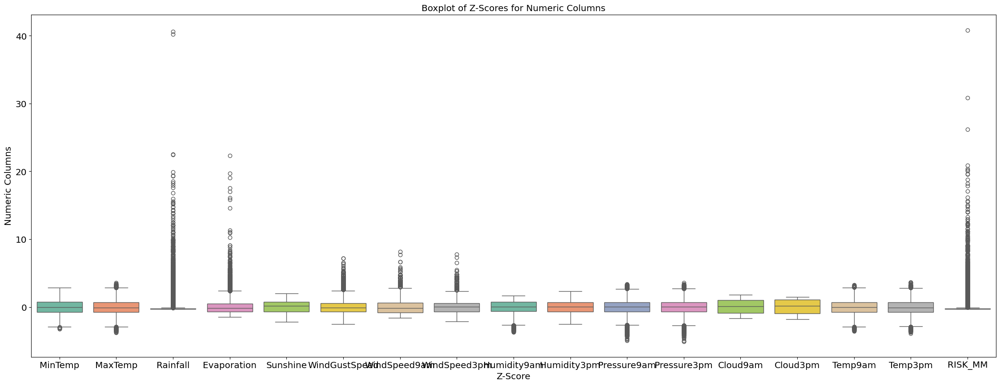

Total data row count => 36261
Oultlier row count => 2542


In [298]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

# Calculate z-scores for each numeric column
weatherAUS_df_numeric = weatherAUS_df.select_dtypes(include=['number'])
print(weatherAUS_df_numeric.columns.tolist())
z_scores = stats.zscore(weatherAUS_df_numeric)

# Create a DataFrame of z-scores
z_scores_df = pd.DataFrame(z_scores, columns=weatherAUS_df.select_dtypes(include=np.number).columns)

# Set up the boxplot figure
plt.figure(figsize=(28, 10))

# Draw boxplots for each numeric column
sns.boxplot(data=z_scores_df, orient='v', palette='Set2')

# Add title and labels
plt.title('Boxplot of Z-Scores for Numeric Columns')
plt.xlabel('Z-Score')
plt.ylabel('Numeric Columns')

# Display the plot
plt.show()

threshold = 3
abs_z_scores = np.abs(z_scores)
# Find rows with any z-score exceeding the threshold
print("Total data row count =>",weatherAUS_df.shape[0])
outlier_rows = weatherAUS_df[(abs_z_scores > threshold).any(axis=1)]
print("Oultlier row count =>",outlier_rows.shape[0])







In [299]:
# We only take the data with no outliers
weatherAUS_df = weatherAUS_df[(abs_z_scores <= threshold).all(axis=1)]

#### **Encoding categorical data**
> - Performed  Encoding of  the Target Variable
> - Performed one-hot encoding, and transformed the boolean cell value to binary representation to the categorical data.

In [300]:
# Label Encoding the Target Variable
weatherAUS_df['RainTomorrow']= weatherAUS_df['RainTomorrow'].replace({"Yes":1, "No":0}) 
weatherAUS_df['RainTomorrow'] = weatherAUS_df['RainTomorrow'].astype(int)

# Perform one-hot encoding on all categorical columns
weatherAUS_final_df = pd.get_dummies(weatherAUS_df)
weatherAUS_final_df.replace({True: 1, False: 0}, inplace=True)


/var/folders/hy/3_vn5bpn6j3_b20776zw1zpr0000gn/T/ipykernel_67025/2196558029.py:2: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  weatherAUS_df['RainTomorrow']= weatherAUS_df['RainTomorrow'].replace({"Yes":1, "No":0})
/var/folders/hy/3_vn5bpn6j3_b20776zw1zpr0000gn/T/ipykernel_67025/2196558029.py:7: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  weatherAUS_final_df.replace({True: 1, False: 0}, inplace=True)


**Viewing First Rows**
The `head()` method was employed to display the first 5 rows of the data frame, allowing a quick glimpse of the data.



In [301]:
print(weatherAUS_final_df.head())

   MinTemp  MaxTemp  Rainfall  Evaporation  Sunshine  WindGustSpeed  \
0      5.1     14.3       0.0         1.80      8.90           30.0   
1      1.1     14.5       0.4         1.92      6.24           50.0   
2     19.7     26.2       0.0         7.20      7.20           41.0   
3     16.6     28.0       0.0         9.00     11.30           54.0   
4     14.6     25.3       0.0         5.92      9.30           43.0   

   WindSpeed9am  WindSpeed3pm  Humidity9am  Humidity3pm  ...  WindDir3pm_S  \
0           7.0           6.0         65.0         47.0  ...             0   
1           7.0          24.0         99.0         46.0  ...             0   
2          19.0          31.0         48.0         50.0  ...             0   
3          28.0          33.0         50.0         41.0  ...             0   
4           6.0          28.0         64.0         67.0  ...             0   

   WindDir3pm_SE  WindDir3pm_SSE  WindDir3pm_SSW  WindDir3pm_SW  WindDir3pm_W  \
0              0       

**Dataset Information**

The `info()` method was used to obtain an overview of the dataset, including the number of columns, rows, and data types of each column.

In [302]:
print(weatherAUS_final_df.info())

<class 'pandas.core.frame.DataFrame'>
Index: 33719 entries, 0 to 36880
Columns: 114 entries, MinTemp to RainToday_Yes
dtypes: float64(17), int64(97)
memory usage: 29.6 MB
None


**Q1.2.** **Visualize the dataset**

Following steps were carried to visaulize dataset and gain insights:
 1. Histogram plot between features and target to gain insights on the feature distribution with respect to target `RainTomorrow`.
 2. Scatter matrix between every features and the target to see the scattering of data points and to get visual of relationships.
 3. Create Co-relation matrix of `RainTomorrow` with other features to detect if there is weak relation such that some feature could be rule out if it is the uncorrelated feature. 
 


**Histogram: Feature datapoint distribution with respect to Target**

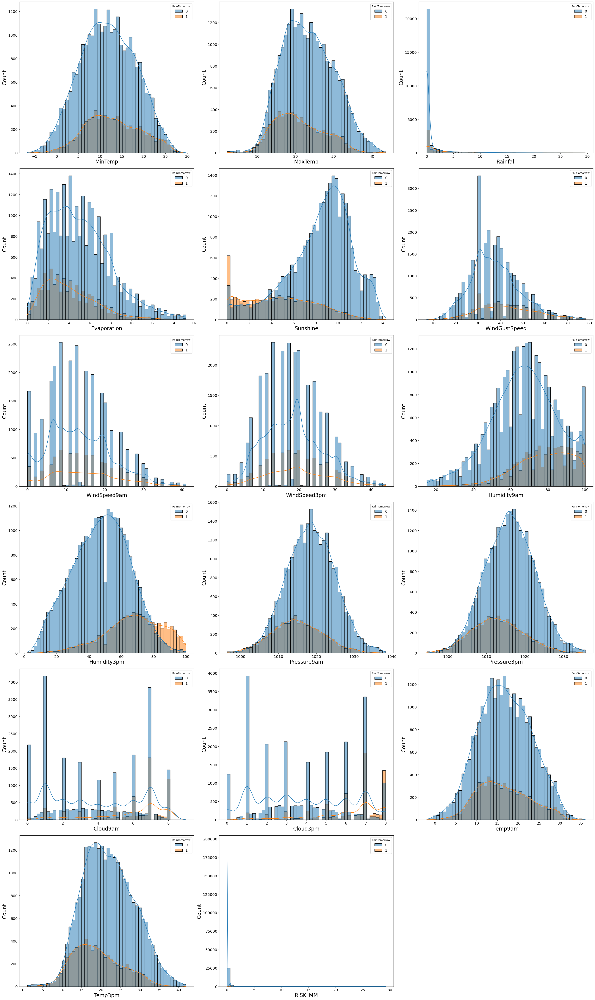

In [303]:
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
import seaborn as sns

weatherAUS_df_numerics = weatherAUS_df.select_dtypes(include=['number'])
params = {
    'legend.fontsize': 'x-large',
    'figure.figsize': (15, 5),
    'axes.labelsize': 'x-large',
    'axes.titlesize':'x-large',
    'xtick.labelsize':'x-large',
    'ytick.labelsize':'x-large'
}
pylab.rcParams.update(params)

plt.figure(figsize=(32, 62))

num_cols = 3
num_rows = int(weatherAUS_df_numerics.shape[1] / num_cols) + 1

for index, col in enumerate(weatherAUS_df_numerics.drop('RainTomorrow', axis=1).columns):
    plt.subplot(num_rows, num_cols, index + 1)
    sns.histplot(weatherAUS_df_numerics, x=col, hue='RainTomorrow', kde=True, bins=50)

    # Increase x-axis and y-axis title font size
    plt.xlabel(col, fontsize=20)
    plt.ylabel('Count', fontsize=20)

plt.tight_layout()
plt.show()

**Scatter Matrix: Between Every Features, and the Target**

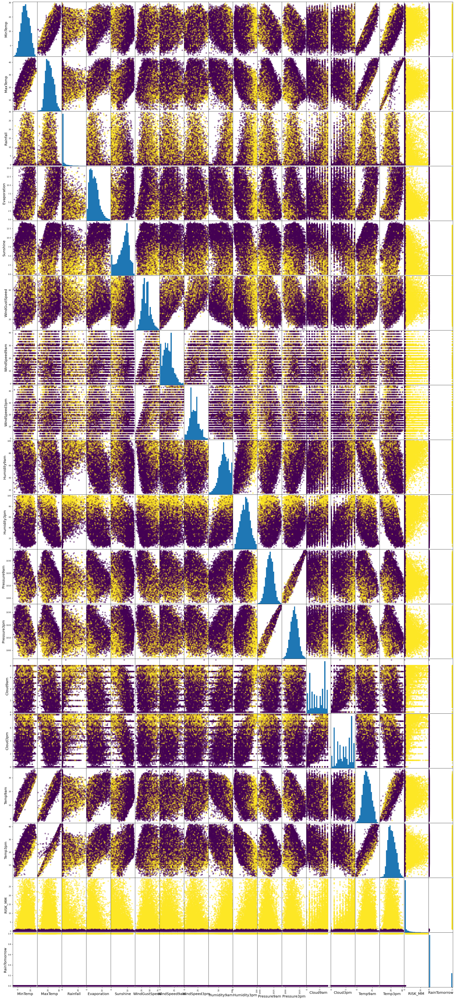

In [304]:
from pandas.plotting import scatter_matrix
attributes = weatherAUS_df_numerics.columns.tolist()
scatter_matrix(weatherAUS_df_numerics[attributes], figsize=(32, 72), c=weatherAUS_df_numerics['RainTomorrow'], marker='o', hist_kwds={'bins': 20}, alpha=0.5)
plt.show()

**Scatter Plot Between Target and Features**

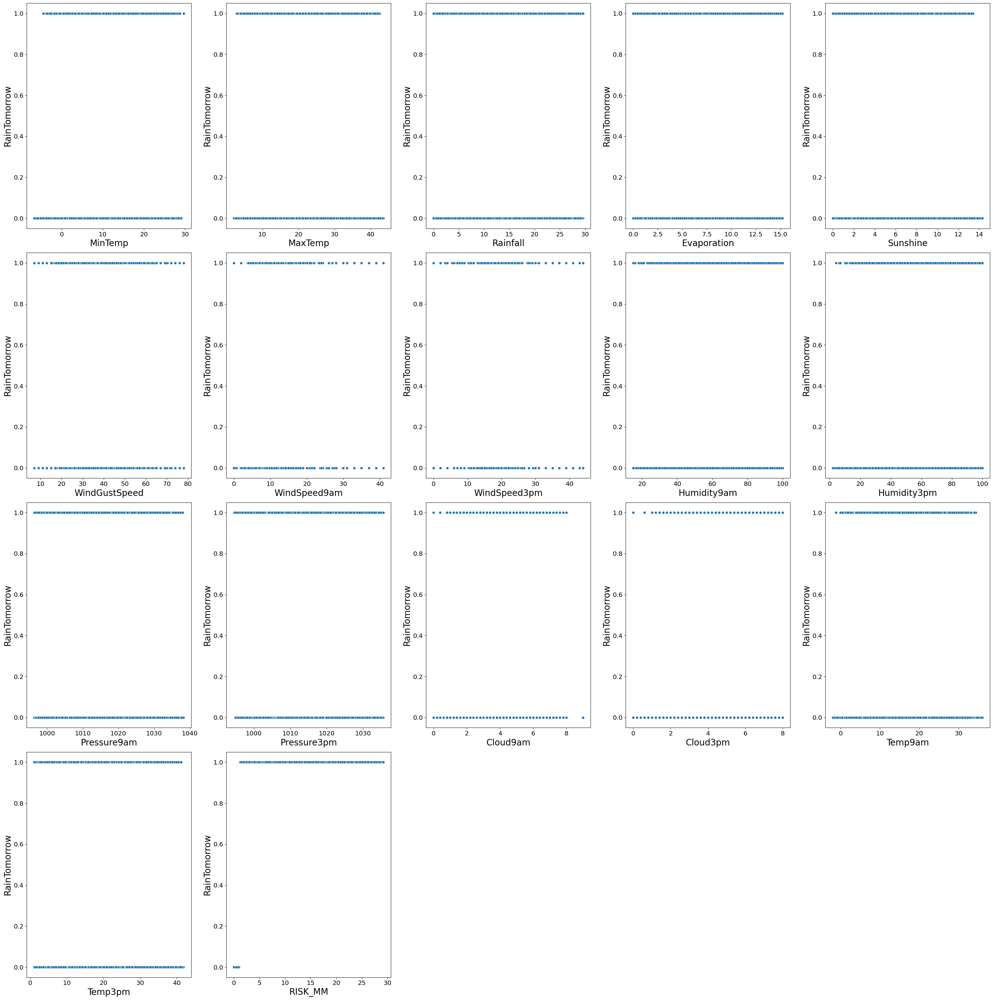

In [305]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(32, 32))

num_cols = 5
num_rows = int(weatherAUS_df_numerics.shape[1] / num_cols) + 1

for index, col in enumerate(weatherAUS_df_numerics.drop('RainTomorrow', axis=1).columns):
    plt.subplot(num_rows, num_cols, index + 1)
    sns.scatterplot(data=weatherAUS_df_numerics, x=col, y='RainTomorrow')

    # Increase x-axis and y-axis title font size
    plt.xlabel(col, fontsize=20)
    plt.ylabel('RainTomorrow', fontsize=20)

plt.tight_layout()
plt.show()


**Correlational Matrix Heatmap**

MinTemp          0.076086
MaxTemp         -0.146493
Rainfall         0.265920
Evaporation     -0.128704
Sunshine        -0.445755
WindGustSpeed    0.196306
WindSpeed9am     0.074276
WindSpeed3pm     0.065096
Humidity9am      0.240322
Humidity3pm      0.425983
Pressure9am     -0.215634
Pressure3pm     -0.198096
Cloud9am         0.323995
Cloud3pm         0.391222
Temp9am         -0.022424
Temp3pm         -0.181483
RISK_MM          0.704527
RainTomorrow     1.000000
Name: RainTomorrow, dtype: float64


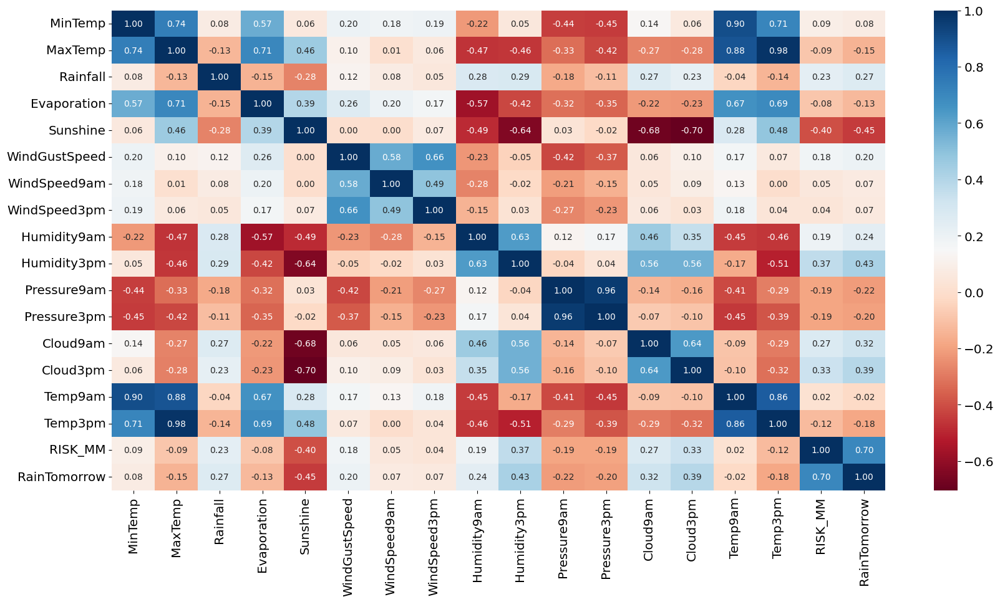

In [306]:
weatherAUS_df_corr_matrix = weatherAUS_df_numerics.corr(numeric_only=True)
print(weatherAUS_df_corr_matrix['RainTomorrow'])
fig, ax = plt.subplots(figsize=(20, 10))
sns.heatmap(weatherAUS_df_numerics.corr(numeric_only=True), cmap='RdBu', annot=True, fmt=".2f");

**Box Plot: Features Vs. Target**

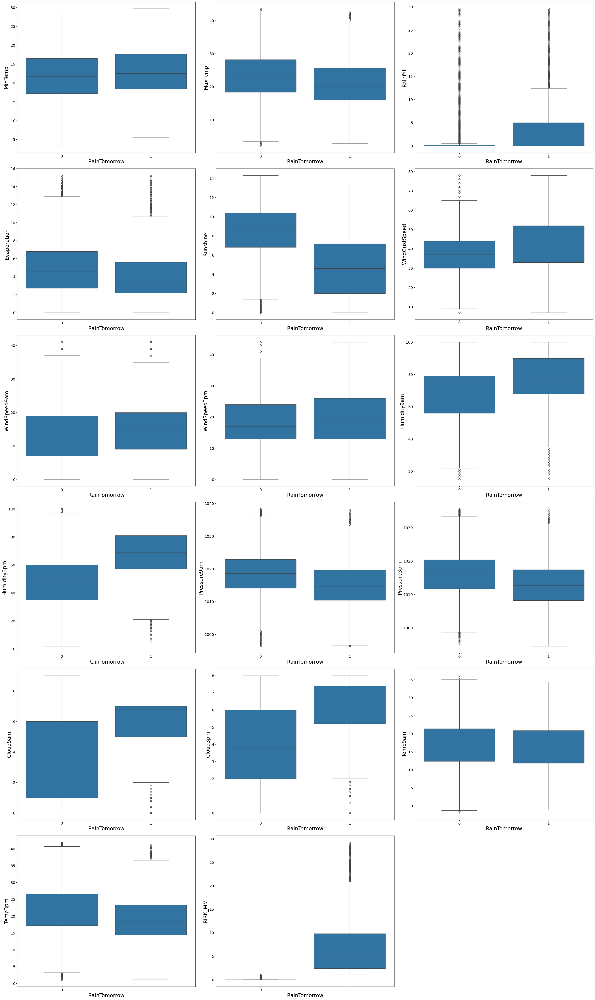

In [307]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(32, 62))

num_cols = 3
num_rows = int(weatherAUS_df_numerics.shape[1] / num_cols) + 1

for index, col in enumerate(weatherAUS_df_numerics.drop('RainTomorrow', axis=1).columns):
    plt.subplot(num_rows, num_cols, index + 1)
    sns.boxplot(data=weatherAUS_df_numerics, x='RainTomorrow', y=col)

    # Increase x-axis and y-axis title font size
    plt.xlabel('RainTomorrow', fontsize=20)
    plt.ylabel(col, fontsize=20)

plt.tight_layout()
plt.show()

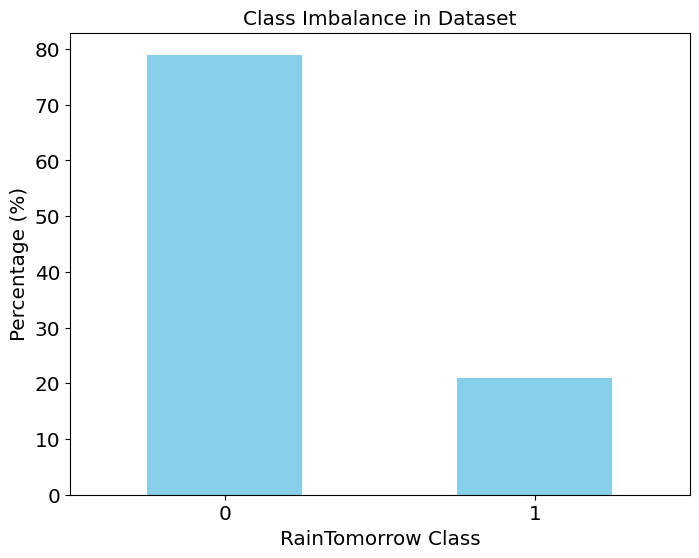

In [308]:
import matplotlib.pyplot as plt

# Calculate the count of each class
class_counts = weatherAUS_final_df['RainTomorrow'].value_counts()

# Calculate the percentage of each class
class_imbalance_percentage = (class_counts / len(weatherAUS_final_df)) * 100

# Plot the histogram
plt.figure(figsize=(8, 6))
class_imbalance_percentage.plot(kind='bar', color='skyblue')
plt.title('Class Imbalance in Dataset')
plt.xlabel('RainTomorrow Class')
plt.ylabel('Percentage (%)')
plt.xticks(rotation=0)  # Rotate x-axis labels if needed
plt.show()


#### **Q1.3.** **Discuss the preliminary observations about the dataset. You may base your discussion on your visualizations, measures of central tendency, and measures of variability**

>The preliminary observations about the dataset shows that there were un-ncecessay features like **`Date` and `Location`**, which we got rid of, the model was trained prior with those columns however, did not observed much change in model performance.
>Also the **class imbalance** was observed in the dataset, with almost 75% of data belonging to NO class and 25% to Yes Class for Target RainTomorrow.

>From the visualization such as scatter plot and the co-relation matrix we can see that features such as **`RISK_MM`, `Humidity3pm`, `Sunshine`, `Cloud3pm`** have a little good co-relation with RainTomorrow Target. While when we make observation on the features with the low correlation, we need to be aware that there could be a case that two features in together could be affecting the `RainTomorrow`. So dropping the features all the time might not be a solution, also might create an overfitting problem.The histogram plot has aided in finding out the distribution of the features with respect to different types of `RainTomorrow` class.

#### **Q1.4. Build a classification model using Logistic Regression to predict the target variable `RainTomorrow` from the dataset.**


In [309]:
# Getting independent and dependent variables
y = weatherAUS_final_df.RainTomorrow.values
X = weatherAUS_final_df.drop(['RainTomorrow'], axis=1)


In [310]:
# Splitting the dataset into training and testing datasets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [311]:
# Normalizing the independent variables: Makes the convergence faster
X_train=(X_train-np.min(X_train, axis=0))/(np.max(X_train, axis=0)-np.min(X_train, axis=0))
X_test=(X_test-np.min(X_test, axis=0))/(np.max(X_test, axis=0)-np.min(X_test, axis=0))

In [312]:
X_train

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,RainToday_No,RainToday_Yes
31025,0.522346,0.453012,0.000000,0.183727,0.328671,0.450704,0.414634,0.500000,0.988235,0.704082,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
31412,0.405028,0.313253,0.033784,0.131234,0.356643,0.467606,0.097561,0.431818,0.847059,0.479592,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
9076,0.807263,0.814458,0.000000,0.892388,0.888112,0.633803,0.268293,0.500000,0.305882,0.540816,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
34246,0.782123,0.667470,0.000000,0.748031,0.020979,0.605634,0.414634,0.704545,0.435294,0.367347,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
6495,0.689944,0.648193,0.364865,0.446194,0.454545,0.732394,0.268293,0.431818,0.847059,0.295918,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18422,0.505587,0.390361,0.121622,0.367454,0.566434,0.346479,0.097561,0.431818,0.552941,0.408163,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
6858,0.667598,0.742169,0.000000,0.443570,0.695105,0.239437,0.097561,0.159091,0.529412,0.346939,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
12361,0.865922,0.754217,0.000000,0.354331,0.727273,0.323944,0.268293,0.386364,0.717647,0.571429,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
964,0.396648,0.373494,0.331081,0.170604,0.657343,0.478873,0.414634,0.500000,0.705882,0.479592,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0


In [313]:
X_test

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,RainToday_No,RainToday_Yes
4207,0.649025,0.764706,0.000000,0.710526,0.943262,0.681159,0.682927,0.454545,0.341176,0.164948,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3857,0.540390,0.642157,0.000000,0.657895,0.751773,0.913043,0.463415,0.795455,0.423529,0.278351,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
34811,0.415042,0.357843,0.000000,0.400000,0.629787,0.405797,0.414634,0.431818,0.400000,0.505155,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
16139,0.551532,0.482843,0.000000,0.163158,0.317730,0.159420,0.268293,0.204545,0.776471,0.690722,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
34555,0.534819,0.450980,0.000000,0.223684,0.248227,0.144928,0.219512,0.204545,0.658824,0.288660,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,0.637883,0.796569,0.000000,0.589474,0.829787,0.652174,0.146341,0.204545,0.517647,0.123711,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
10280,0.607242,0.850490,0.000000,0.315789,0.822695,0.536232,0.268293,0.545455,0.729412,0.216495,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
36701,0.587744,0.441176,0.040541,0.460526,0.851064,0.463768,0.585366,0.545455,0.517647,0.577320,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
17696,0.192201,0.181373,0.000000,0.097368,0.392908,0.376812,0.170732,0.295455,0.800000,0.587629,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [314]:
# fitting the logistic regression model to the training data
from sklearn.linear_model import LogisticRegression
logre = LogisticRegression()
logre.fit(X_train,y_train)

LogisticRegression()

In [315]:
# predicting the class for the test data
y_pred = logre.predict(X_test)


In [316]:
custom_threshold = 0.3
y_pred_custom = (logre.predict_proba(X_test)[:, 1] > custom_threshold).astype(int)


In [317]:
y_pred_custom

array([0, 0, 0, ..., 0, 0, 0])

In [318]:
from sklearn.metrics import accuracy_score
print(accuracy_score(y_test,y_pred))

0.9673784104389087


In [319]:
print(accuracy_score(y_test,y_pred_custom))

0.9793890865954923


In [320]:
from sklearn.metrics import classification_report
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.96      1.00      0.98      5358
           1       1.00      0.84      0.91      1386

    accuracy                           0.97      6744
   macro avg       0.98      0.92      0.95      6744
weighted avg       0.97      0.97      0.97      6744



[[5354    4]
 [ 216 1170]]


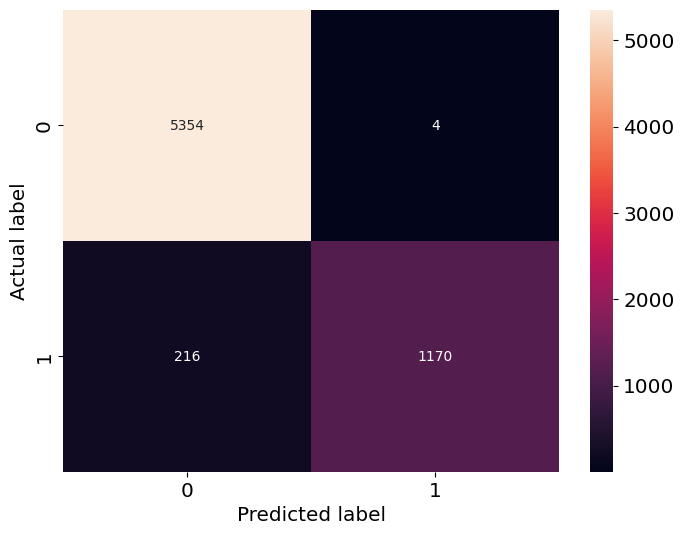

In [321]:
from sklearn.metrics import confusion_matrix
plt.figure(figsize=(8,6))

print(confusion_matrix(y_test,y_pred))
sns.heatmap(confusion_matrix(y_test,y_pred),annot=True, fmt='.4g')
plt.xlabel('Predicted label');
plt.ylabel('Actual label');

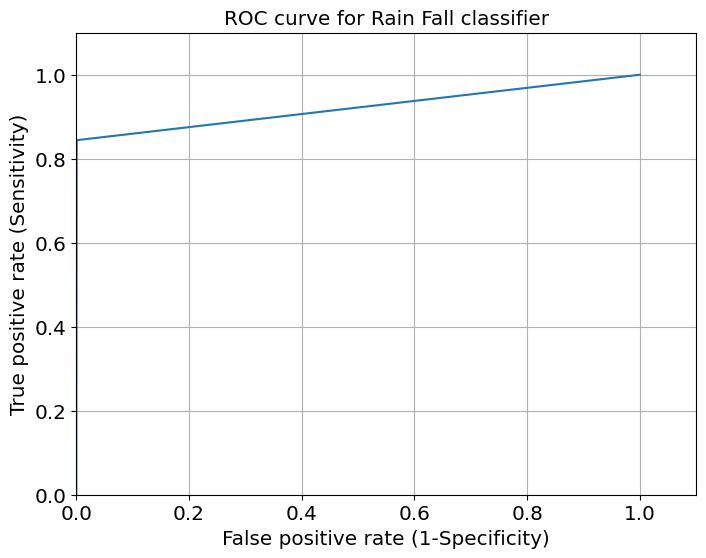

In [322]:
from sklearn.metrics import roc_curve
plt.figure(figsize=(8,6))

fpr, tpr, thresholds = roc_curve(y_test, y_pred)
plt.plot(fpr,tpr)
plt.xlim([0.0, 1.1])
plt.ylim([0.0, 1.1])
plt.title('ROC curve for Rain Fall classifier')
plt.xlabel('False positive rate (1-Specificity)')
plt.ylabel('True positive rate (Sensitivity)')
plt.grid(True)

In [323]:
from sklearn.metrics import roc_auc_score
roc_auc_score(y_test,y_pred)

0.9217046484683663

#### **Q1.5. Evaluate and discuss the model performance**
**Accuracy:** The overall accuracy of the model is 96.74%, which means that it correctly predicts whether it will rain or not approximately 97 times out of 100. 

**Precision:** 
For class 0 (no rainfall), precision is 96%, which indicates that when the model predicts no rainfall, it is correct 96% of the time. For class 1 (RainTomorrow -Yes), precision is 100%, meaning that when the model predicts rainfall, it is correct all the time. This suggests that the model is very good at avoiding false positive predictions.

**Recall (Sensitivity):** For class 0, recall is 100%, indicating that the model correctly identifies all instances of no rainfall. For class 1, recall is 84%, suggesting that the model identifies 84% of actual rainfall events. This implies that the model is slightly less sensitive in detecting rainfall events compared to correctly identifying instances of no rainfall.

**F1-score:**  For class 0, the F1-score is 98%, and for class 1, it is 91%. These scores indicate that the model achieves a good balance between precision and recall for both classes.

**ROC Score:** The ROC score is a measure of the model's ability to distinguish between the two classes. A score of 0.92 suggests that the model performs well in this regard, with a high true positive rate and a low false positive rate.

Also, it was observed that when the threshold was put 0.3, and model fit was done, the accuracy was computed to be aprox. 98 %.
 rate.



# Question 2: Multi-Class Classification Using Logistic Regression
<hr style="border:1px solid orange"> </hr>

#### Read the content of the `penguins.csv` file and perform the following:

> **Q2.1.** Preprocess and clean the dataset (**Note:** Make sure to document your preprocessing step): This step should include the following:

        - Dealing with the missing data
        - Dealing with the irregular data (outliers)
        - Dealing with the unnecessary data
        - Dealing with the inconsistent data
        - Encoding categorical data 
        
> **Q2.2.** Visualize the dataset

> **Q2.3.** Discuss the preliminary observations about the dataset. You may base your discussion on your visualizations, measures of central tendency, and measures of variability 

> **Q2.4.** Build a classification model using Logistic Regression to predict the penguins species.

> **Q2.5.** Evaluate and discuss the model performance 

In [324]:
import pandas as pd

In [325]:
penguin_df = pd.read_csv('penguins.csv')
print(penguin_df.head())

  species     island  bill_length_mm  bill_depth_mm  flipper_length_mm  \
0  Adelie  Torgersen            39.1           18.7              181.0   
1  Adelie  Torgersen            39.5           17.4              186.0   
2  Adelie  Torgersen            40.3           18.0              195.0   
3  Adelie  Torgersen             NaN            NaN                NaN   
4  Adelie  Torgersen            36.7           19.3              193.0   

   body_mass_g     sex  
0       3750.0    MALE  
1       3800.0  FEMALE  
2       3250.0  FEMALE  
3          NaN     NaN  
4       3450.0  FEMALE  


#### **Q2.1.Preprocess and clean the dataset (**Note:** Make sure to document your preprocessing step): This step should include the following**

        - Dealing with the missing data
        - Dealing with the irregular data (outliers)
        - Dealing with the unnecessary data
        - Dealing with the inconsistent data
        - Encoding categorical data 

**Dealing with the missing ,unnecessay and inconsistent data**
- Find the NA values in feature columns
- Two rows with no values in almost all the feature columns were dropped. As two is really low no of rows, so it seems okay to drop.
- While the NA values from the feature `sex` was filled using mode imputation method.

  

In [326]:
#Find the NA values
print("Total Rows =>",penguin_df.shape[0])
print("NA count across rows\n",penguin_df.isna().sum())



Total Rows => 344
NA count across rows
 species               0
island                0
bill_length_mm        2
bill_depth_mm         2
flipper_length_mm     2
body_mass_g           2
sex                  11
dtype: int64


In [327]:
# Dropping the rows with NA values in those rows
penguin_df.dropna(subset=['bill_length_mm', 'bill_depth_mm', 'flipper_length_mm', 'body_mass_g'], inplace=True)

**Impute the missing value for `sex` feature using mode**

In [328]:
# Assuming penguin_df is your DataFrame containing the penguin data

# Importing pandas library
import pandas as pd

# Calculate mode of 'sex' column
mode_sex = penguin_df['sex'].mode()[0]

# Fill NaN values in 'sex' column with the mode
penguin_df['sex'] = penguin_df['sex'].fillna(mode_sex)
print(penguin_df.isna().sum())


species              0
island               0
bill_length_mm       0
bill_depth_mm        0
flipper_length_mm    0
body_mass_g          0
sex                  0
dtype: int64


**Dealing with the irregular data (outliers)**
- Visualized the outlier using the box plot, use z score method to show them in the boxplot
- Total number of outlier rows were printed

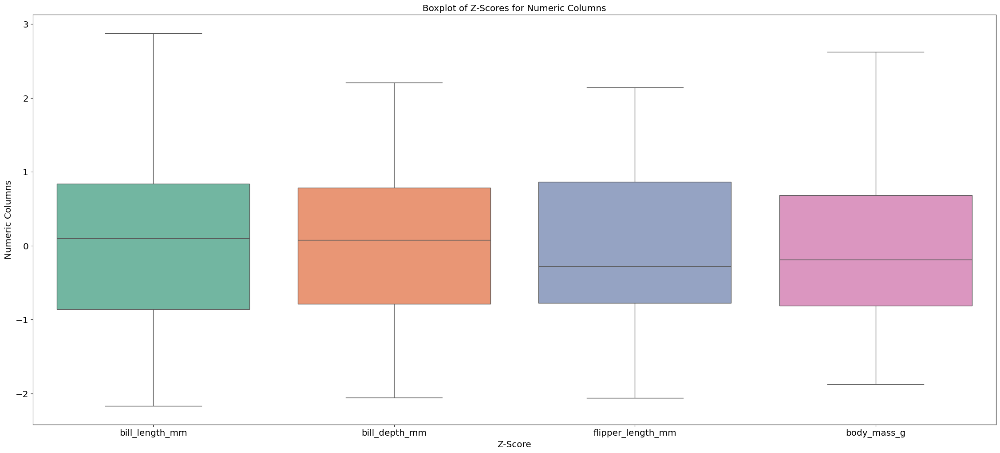

Total outlier rows => 0


In [329]:
import seaborn as sns
import matplotlib.pyplot as plt

import numpy as np
from scipy.stats import zscore


# Calculate z-scores for each numeric column
z_scores = zscore(penguin_df.select_dtypes(include=np.number))

# Create a DataFrame of z-scores
z_scores_df = pd.DataFrame(z_scores, columns=penguin_df.select_dtypes(include=np.number).columns)

# Set up the boxplot figure
plt.figure(figsize=(28, 12))

# Draw boxplots for each numeric column
sns.boxplot(data=z_scores_df, orient='v', palette='Set2')

# Add title and labels
plt.title('Boxplot of Z-Scores for Numeric Columns')
plt.xlabel('Z-Score')
plt.ylabel('Numeric Columns')

# Display the plot
plt.show()

threshold = 3
abs_z_scores = np.abs(z_scores)
# Find rows with any z-score exceeding the threshold
outlier_rows = penguin_df[(abs_z_scores > threshold).any(axis=1)]
print("Total outlier rows =>", outlier_rows.shape[0])
penguin_df = penguin_df[(abs_z_scores <= threshold).all(axis=1)]





#### **Encoding categorical data**
- Target Variable `species` was label encoded using the `LabelEncoder`
- Categorical data were one hot encoded using `get_dummies` method

In [330]:
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()

penguin_df['species'] = label_encoder.fit_transform(penguin_df.species)

In [331]:

penguin_df = pd.get_dummies(penguin_df)
penguin_df = penguin_df.replace({True:1, False:0})
print(penguin_df.head(20))

    species  bill_length_mm  bill_depth_mm  flipper_length_mm  body_mass_g  \
0         0            39.1           18.7              181.0       3750.0   
1         0            39.5           17.4              186.0       3800.0   
2         0            40.3           18.0              195.0       3250.0   
4         0            36.7           19.3              193.0       3450.0   
5         0            39.3           20.6              190.0       3650.0   
6         0            38.9           17.8              181.0       3625.0   
7         0            39.2           19.6              195.0       4675.0   
8         0            34.1           18.1              193.0       3475.0   
9         0            42.0           20.2              190.0       4250.0   
10        0            37.8           17.1              186.0       3300.0   
11        0            37.8           17.3              180.0       3700.0   
12        0            41.1           17.6              182.0   

/var/folders/hy/3_vn5bpn6j3_b20776zw1zpr0000gn/T/ipykernel_67025/2175311353.py:2: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  penguin_df = penguin_df.replace({True:1, False:0})


#### **Q2.2. Visualize the dataset**
Following steps were carried to visaulize dataset and gain insights:
 1. Histogram plot between features and target in order to gain insights on the feature distribution with respect to target `species`
 2. Scatter matrix between every features and the target to see the scattering of data points and to get visual of relationships.
 3. Create Correlation matrix of `species` with other features to detect if there is weak relation such that some feature could be rule out if it is the uncorrelated feature. 


**Histogram: Feature datapoint distribution with respect to Target**

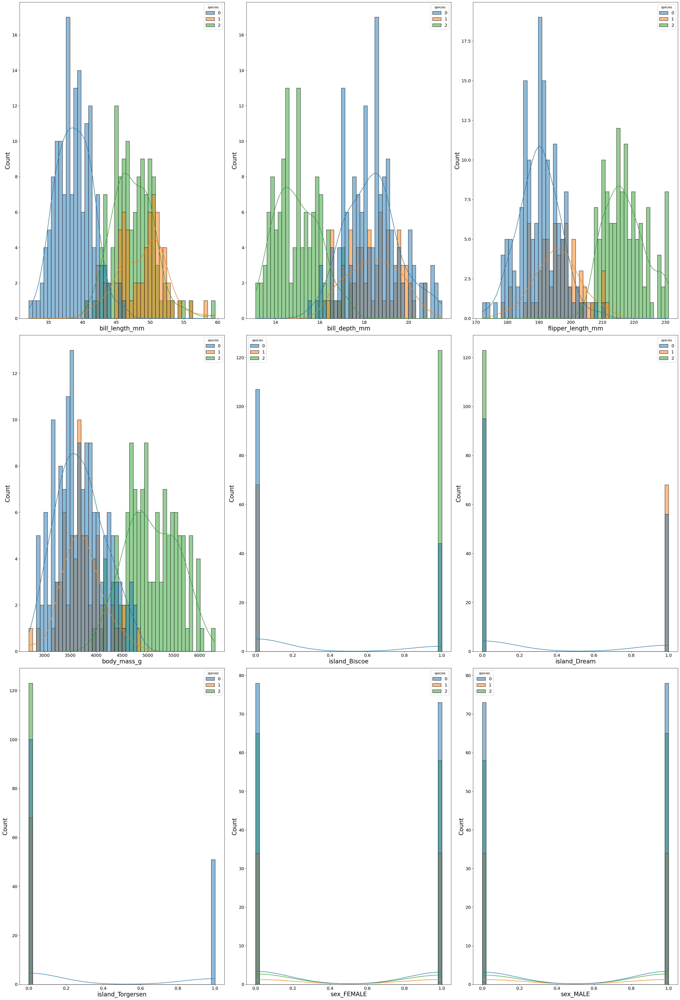

In [332]:
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
import seaborn as sns


params = {
    'legend.fontsize': 'x-large',
    'figure.figsize': (15, 5),
    'axes.labelsize': 'x-large',
    'axes.titlesize':'x-large',
    'xtick.labelsize':'x-large',
    'ytick.labelsize':'x-large'
}
pylab.rcParams.update(params)

plt.figure(figsize=(32, 62))

num_cols = 3
num_rows = int(penguin_df.shape[1] / num_cols) + 1
palette = sns.color_palette('tab10', n_colors=len(penguin_df['species'].unique()))
for index, col in enumerate(penguin_df.drop('species', axis=1).columns):
    plt.subplot(num_rows, num_cols, index + 1)
    sns.histplot(penguin_df, x=col, hue='species', kde=True, bins=50, palette=palette)

    # Increase x-axis and y-axis title font size
    plt.xlabel(col, fontsize=20)
    plt.ylabel('Count', fontsize=20)

plt.tight_layout()
plt.show()

**Scatter Matrix: Between Every Features, and the Target**

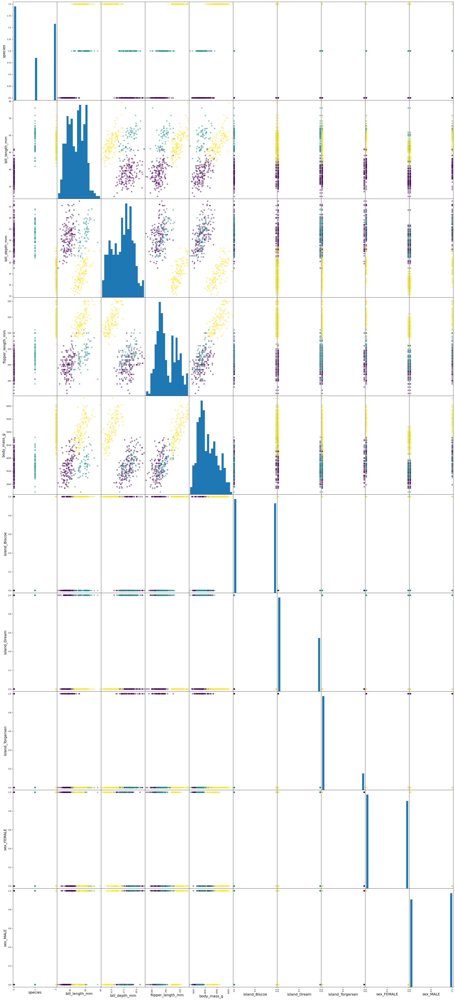

In [333]:
from pandas.plotting import scatter_matrix

# List of attributes for scatter matrix
attributes = penguin_df.columns.tolist()

# Add hue to the scatter matrix plot
scatter_matrix(penguin_df[attributes], figsize=(32, 72), c=penguin_df['species'], marker='o', hist_kwds={'bins': 20}, alpha=0.5)
plt.show()

**Scatter plot: Features Vs. Target**

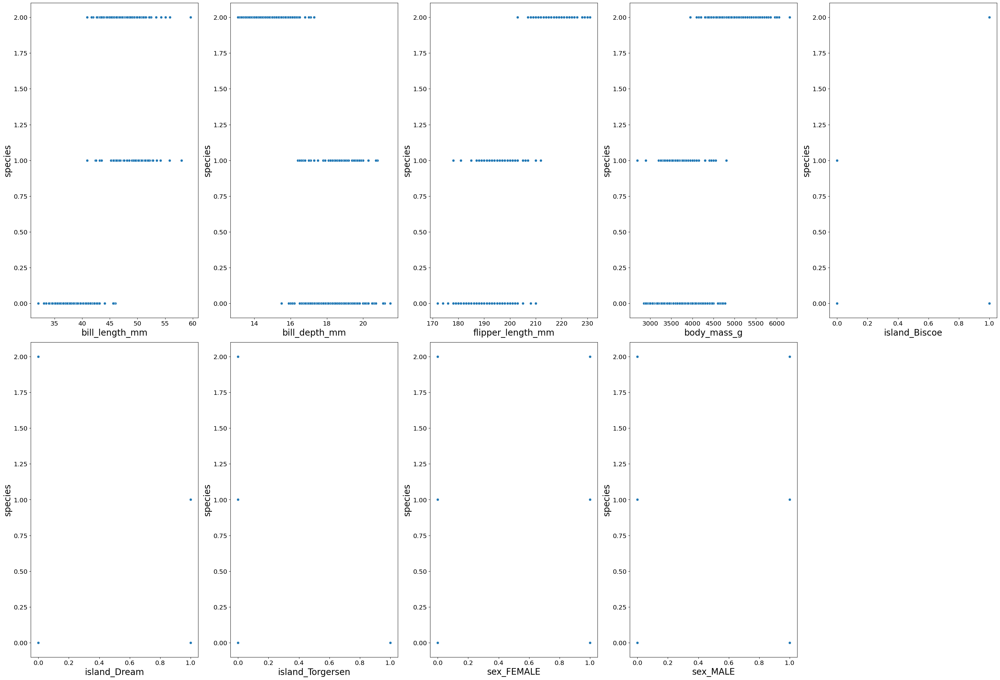

In [334]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(32, 32))

num_cols = 5
num_rows = int(penguin_df.shape[1] / num_cols) + 1

for index, col in enumerate(penguin_df.drop('species', axis=1).columns):
    plt.subplot(num_rows, num_cols, index + 1)
    sns.scatterplot(data=penguin_df, x=col, y='species')

    # Increase x-axis and y-axis title font size
    plt.xlabel(col, fontsize=20)
    plt.ylabel('species', fontsize=20)

plt.tight_layout()
plt.show()


**Correlational Heatmap**

species              1.000000
bill_length_mm       0.731369
bill_depth_mm       -0.744076
flipper_length_mm    0.854307
body_mass_g          0.750491
island_Biscoe        0.608185
island_Dream        -0.312855
island_Torgersen    -0.431225
sex_FEMALE          -0.009790
sex_MALE             0.009790
Name: species, dtype: float64


<Axes: >

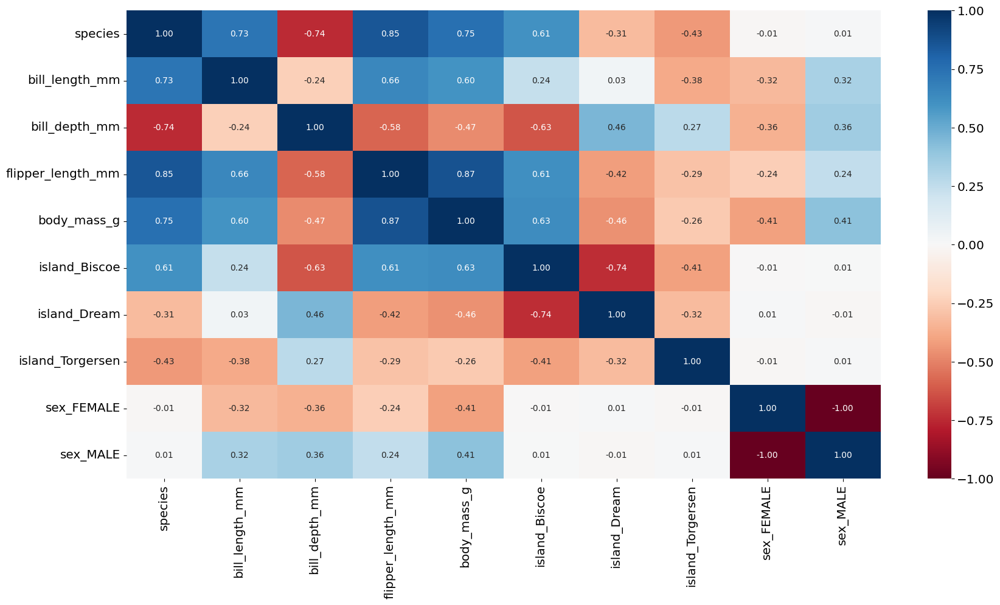

In [335]:
penguin_df_corr_matrix = penguin_df.corr()
print(penguin_df_corr_matrix['species'])
fig, ax = plt.subplots(figsize=(20, 10))
sns.heatmap(penguin_df.corr(numeric_only=True), cmap='RdBu', annot=True, fmt=".2f")

#### **Q2.3.** **Discuss the preliminary observations about the dataset. You may base your discussion on your visualizations, measures of central tendency, and measures of variability**

>The preliminary observations about the dataset shows that there were NA values or the empty cell values. They were handled by removing few rows and performing the `mode` imputation method.


>From the visualization such as scatter plot, scatter-matrix and the correlation matrix we can see that features such as `flipper_length_mm`, `bill_depth_mm`, `bill_length_mm` have a strong co-relation with `species` Target. While when we make observation on the features with the low correlation, we need to be aware that there could be a case that two features in together could be affecting the `species`. So dropping the features all the time might not be a solution, also might create an overfitting problem. The histogram plot has aided in finding out the distribution of the features with respect to different types of `species` class.

#### **Q2.4. Build a classification model using Logistic Regression to predict the penguins species.**

In [336]:
y = penguin_df.species.values
X = penguin_df.drop(['species'], axis=1)


In [337]:
# Splitting the dataset into training and testing datasets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [338]:
# Normalizing the independent variables: Makes the convergence faster
X_train=(X_train-np.min(X_train, axis=0))/(np.max(X_train, axis=0)-np.min(X_train, axis=0))
X_test=(X_test-np.min(X_test, axis=0))/(np.max(X_test, axis=0)-np.min(X_test, axis=0))

In [339]:
from sklearn.linear_model import LogisticRegression
logre = LogisticRegression()
logre.fit(X_train,y_train)

LogisticRegression()

In [340]:

y_pred = logre.predict(X_test)
from sklearn.metrics import accuracy_score
print(accuracy_score(y_test,y_pred))


0.9855072463768116


In [341]:
from sklearn.metrics import classification_report
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.97      1.00      0.99        35
           1       1.00      0.92      0.96        12
           2       1.00      1.00      1.00        22

    accuracy                           0.99        69
   macro avg       0.99      0.97      0.98        69
weighted avg       0.99      0.99      0.99        69



[[35  0  0]
 [ 1 11  0]
 [ 0  0 22]]


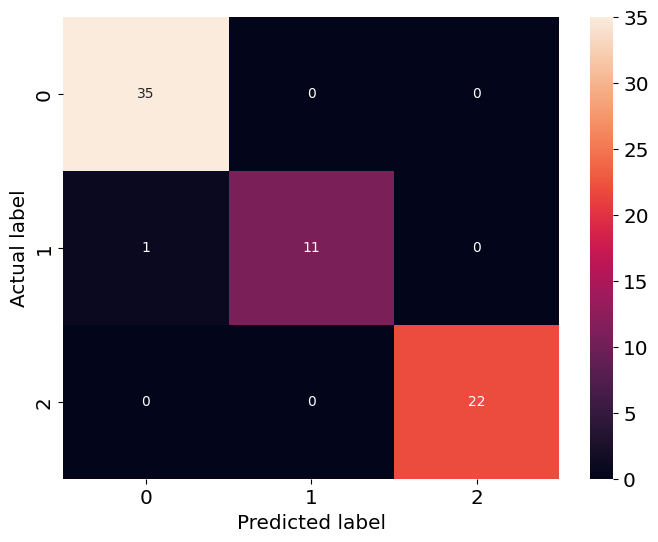

In [342]:
from sklearn.metrics import confusion_matrix
plt.figure(figsize=(8,6))

print(confusion_matrix(y_test,y_pred))
sns.heatmap(confusion_matrix(y_test,y_pred),annot=True, fmt='.4g')
plt.xlabel('Predicted label');
plt.ylabel('Actual label');

#### **Q2.5.Evaluate and discuss the model performance**

1. **Accuracy**: The overall accuracy of the model is 98.55%, indicating that it correctly predicts the penguin species in almost 99 out of 100 cases. High accuracy suggests that the model is performing well overall.

2. **Precision, Recall, and F1-Score for Each Class**:
   - **Class 0 (Adelie)**: Precision is 97%, recall is 100%, and the F1-score is 99%. This indicates that the model performs exceptionally well in identifying Adelie penguins, with very few false positives or false negatives.
   - **Class 1 (Chinstrap)**: Precision is 100%, recall is 92%, and the F1-score is 96%. While precision is perfect, there is a slight decrease in recall, indicating that the model may miss some instances of Chinstrap penguins.
   - **Class 2 (Gentoo)**: Precision, recall, and F1-score are all 100%, suggesting that the model performs flawlessly in identifying Gentoo penguins.
3. **Support:** The support represents the number of occurrences of each class in the actual data. In this case, there are 35 instances of class 0 (Adelie), 12 instances of class 1 (Chinstrap), and 22 instances of class 2 (Gentoo).

4. **Macro and Weighted Averages**: The macro average for precision, recall, and F1-score is 0.99, 0.97, and 0.98, respectively. The weighted average for precision, recall, and F1-score is also 0.99, 0.99, and 0.99, respectively. These values indicate a high overall performance across all classes, with minimal bias towards any specific class.

In summary, the model demonstrates excellent performance in distinguishing between different penguin species. The high precision values indicate low false-positive rates, while the high recall values suggest effective identification of true positives. The F1-scores provide a good balance between precision and recall.

<div class="alert alert-block alert-info">

# Part 2: Reflection
    
</div>

As a second step—after answering the questions, include the following:
1. A reflection of your experience performing the activity. 
2. A reflection on the importance of learning this activity.

**Note:** include your reflection in this notebook as markdown cells. 

**1. A reflection of your experience performing the activity.**
>I came to understand the need for data preprocessing in more detail and how it affects model performance. This experience helped me to recognize the issue of class imbalance in part 1, where certain classes might have significantly fewer instances than others, leading to biased model predictions. I am looking forward to querying on these concepts further in class. Overall, this lab has significantly enhanced my practical knowledge and understanding of machine learning classification techniques.

**2. A reflection on the importance of learning this activity.**
>This activity made me realize how important it is to be able to interpret data plots and visualize data effectively, especially for feature engineering. Understanding the patterns and relationships within the data through visualization is crucial for making informed decisions about which features to include in our models and how to preprocess them appropriately. This hands-on learning session not only deepened my understanding of logistic regression and its working mechanism but also taught me the importance of various preprocessing techniques and model evaluation methods. Overall, this experience has highlighted the significance of practical skills in data science and machine learning, equipping me with valuable knowledge for future projects and analyses.

<div class="alert alert-block alert-info">

# Submission
    
</div>

Submit **Lab2.ipynb** to the **Lab 2 - Binary and Multi-class Classification Using Logistic Regression (Dropbox)** on D2L by the due date. 

<div class="alert alert-block alert-info">

# Grading Rubric
    
</div>

| Criterion                                  | Excellent                                                   | Good                                                        | Average                                                    | Below Average                                               | Poor                                                        | No Attempt                                                 |
|--------------------------------------------|-------------------------------------------------------------|-------------------------------------------------------------|------------------------------------------------------------|--------------------------------------------------------------|-------------------------------------------------------------|------------------------------------------------------------|
| **Part 1:** Activity-Question 1.1           | **10 points** - Completes all aspects of the question correctly | **8 points** - Completes most aspects of the question correctly | **6 points** - Completes aspects of the question correctly, and some incorrectly | **4 points** - Completes most aspects of the question incorrectly or does not attempt many aspects | **2 points** - Minimal effort or completes a few aspects of the question or very few correctly | **0 points** - Did not complete the question                   |
| **Part 1:** Activity-Question 1.2           | **10 points** - Completes all aspects of the question correctly | **8 points** - Completes most aspects of the question correctly | **6 points** - Completes aspects of the question correctly, and some incorrectly | **4 points** - Completes most aspects of the question incorrectly or does not attempt many aspects | **2 points** - Minimal effort or completes a few aspects of the question or very few correctly | **0 points** - Did not complete the question                   |
| **Part 1:** Activity-Question 1.3           | **10 points** - Completes all aspects of the question correctly | **8 points** - Completes most aspects of the question correctly | **6 points** - Completes aspects of the question correctly, and some incorrectly | **4 points** - Completes most aspects of the question incorrectly or does not attempt many aspects | **2 points** - Minimal effort or completes a few aspects of the question or very few correctly | **0 points** - Did not complete the question                   |
| **Part 1:** Activity-Question 1.4           | **10 points** - Completes all aspects of the question correctly | **8 points** - Completes most aspects of the question correctly | **6 points** - Completes aspects of the question correctly, and some incorrectly | **4 points** - Completes most aspects of the question incorrectly or does not attempt many aspects | **2 points** - Minimal effort or completes a few aspects of the question or very few correctly | **0 points** - Did not complete the question                   |
| **Part 1:** Activity-Question 1.5           | **10 points** - Completes all aspects of the question correctly | **8 points** - Completes most aspects of the question correctly | **6 points** - Completes aspects of the question correctly, and some incorrectly | **4 points** - Completes most aspects of the question incorrectly or does not attempt many aspects | **2 points** - Minimal effort or completes a few aspects of the question or very few correctly | **0 points** - Did not complete the question                   |
| **Part 1:** Activity-Question 2.1           | **10 points** - Completes all aspects of the question correctly | **8 points** - Completes most aspects of the question correctly | **6 points** - Completes aspects of the question correctly, and some incorrectly | **4 points** - Completes most aspects of the question incorrectly or does not attempt many aspects | **2 points** - Minimal effort or completes a few aspects of the question or very few correctly | **0 points** - Did not complete the question                   |
| **Part 1:** Activity-Question 2.2           | **10 points** - Completes all aspects of the question correctly | **8 points** - Completes most aspects of the question correctly | **6 points** - Completes aspects of the question correctly, and some incorrectly | **4 points** - Completes most aspects of the question incorrectly or does not attempt many aspects | **2 points** - Minimal effort or completes a few aspects of the question or very few correctly | **0 points** - Did not complete the question                   |
| **Part 1:** Activity-Question 2.3           | **10 points** - Completes all aspects of the question correctly | **8 points** - Completes most aspects of the question correctly | **6 points** - Completes aspects of the question correctly, and some incorrectly | **4 points** - Completes most aspects of the question incorrectly or does not attempt many aspects | **2 points** - Minimal effort or completes a few aspects of the question or very few correctly | **0 points** - Did not complete the question                   |
| **Part 1:** Activity-Question 2.4           | **10 points** - Completes all aspects of the question correctly | **8 points** - Completes most aspects of the question correctly | **6 points** - Completes aspects of the question correctly, and some incorrectly | **4 points** - Completes most aspects of the question incorrectly or does not attempt many aspects | **2 points** - Minimal effort or completes a few aspects of the question or very few correctly | **0 points** - Did not complete the question                   |
| **Part 1:** Activity-Question 2.5           | **10 points** - Completes all aspects of the question correctly | **8 points** - Completes most aspects of the question correctly | **6 points** - Completes aspects of the question correctly, and some incorrectly | **4 points** - Completes most aspects of the question incorrectly or does not attempt many aspects | **2 points** - Minimal effort or completes a few aspects of the question or very few correctly | **0 points** - Did not complete the question                   |
| **Part 2:** Reflection                      | **10 points** - Reflection clearly ties to the module content; experience and importance clearly laid out | **8 points** - Reflection mostly ties to the module content; experience & importance are discussed | **6 points** - Reflection ties minimally to the module content; experience & importance are discussed but not thoroughly | **4 points** - Reflection does not tie to the module content; experience & importance are minimally discussed | **2 points** - Minimal effort to tie to content; minimal effort to describe experience/importance | **0 points** - Did not complete the reflection                 |
